In [ ]:
import pandas as pd

# Load all your exported schema files (adjust file paths if needed)
clinical_demographic = pd.read_csv(r"D:\work\extra\prognosis_analysis\demographic.csv")
clinical_diagnosis = pd.read_csv(r"D:\work\extra\prognosis_analysis\diagnosis.csv")
clinical_labs = pd.read_csv(r"D:\work\extra\prognosis_analysis\labs.csv")
clinical_medication= pd.read_csv(r"D:\work\extra\prognosis_analysis\medication.csv")
clinical_vital= pd.read_csv(r"D:\work\extra\prognosis_analysis\vital_sign.csv")
clinical_urin= pd.read_csv(r"D:\work\extra\prognosis_analysis\urine.csv")
derived_heightandweight = pd.read_csv(r"D:\work\extra\prognosis_analysis\heightadnweight.csv")
derived_lab_firstday = pd.read_csv(r"D:\work\extra\prognosis_analysis\lab_firstday.csv")
derived_sofa = pd.read_csv(r"D:\work\extra\prognosis_analysis\sofa.csv")
derived_vital_firstday = pd.read_csv(r"D:\work\extra\prognosis_analysis\vital_first_day.csv")

In [ ]:
# Dictionary of DataFrames
dataframes = {
    "clinical_demographic": clinical_demographic,
    "clinical_diagnosis": clinical_diagnosis,
    "clinical_labs": clinical_labs,
    "clinical_medication": clinical_medication,
    "clinical_vital": clinical_vital,
    "clinical_urin": clinical_urin,
    "derived_heightandweight": derived_heightandweight,
    "derived_lab_firstday": derived_lab_firstday,
    "derived_sofa": derived_sofa,
    "derived_vital_firstday": derived_vital_firstday
}

# Display columns and data types for each DataFrame
for name, df in dataframes.items():
    print(f"DataFrame: {name}")
    print(df.dtypes)
    print("-" * 40)

DataFrame: clinical_demographic
subject_id     int64
hadm_id        int64
gender        object
ethnicity     object
age            int64
dtype: object
----------------------------------------
DataFrame: clinical_diagnosis
subject_id      int64
hadm_id         int64
icd9_code       int64
short_title    object
long_title     object
dtype: object
----------------------------------------
DataFrame: clinical_labs
subject_id      int64
hadm_id         int64
charttime      object
creatinine    float64
dtype: object
----------------------------------------
DataFrame: clinical_medication
subject_id            int64
hadm_id               int64
startdate            object
enddate              object
drug_name_generic    object
route                object
dtype: object
----------------------------------------
DataFrame: clinical_vital
subject_id      int64
hadm_id         int64
icustay_id      int64
charttime      object
heart_rate    float64
dtype: object
----------------------------------------


In [ ]:
import pandas as pd

# STEP 1: Start with clinical_demographic as the base
master_df = clinical_demographic.copy()

# STEP 2: Merge other dataframes using subject_id and hadm_id
master_df = master_df.merge(clinical_urin, on=['subject_id', 'hadm_id'], how='left')
master_df = master_df.merge(clinical_labs, on=['subject_id', 'hadm_id'], how='left')
master_df = master_df.merge(clinical_vital, on=['subject_id', 'hadm_id'], how='left')

# STEP 3: Merge derived tables using subject_id and hadm_id
master_df = master_df.merge(derived_lab_firstday, on=['subject_id', 'hadm_id'], how='left')

# Clean derived_sofa to avoid duplicate 'icustay_id'
derived_sofa_clean = derived_sofa.drop(columns=['icustay_id'], errors='ignore')
master_df = master_df.merge(derived_sofa_clean, on=['subject_id', 'hadm_id'], how='left')

# STEP 4: Merge vitals (first day summary)
derived_vital_firstday_clean = derived_vital_firstday.drop(columns=['icustay_id'], errors='ignore')
master_df = master_df.merge(derived_vital_firstday_clean, on=['subject_id', 'hadm_id'], how='left')

# STEP 5: Now merge derived height/weight using icustay_id
# Ensure icustay_id exists in master_df before merging
if 'icustay_id' in master_df.columns:
    master_df = master_df.merge(derived_heightandweight, on='icustay_id', how='left')
else:
    print("⚠️ 'icustay_id' not found in master_df; skipping height/weight merge.")

# Final sanity check
print(f"✅ Final master_df shape: {master_df.shape}")
print("🧾 Final columns:")
print(master_df.columns.tolist())


✅ Final master_df shape: (1114581, 88)
🧾 Final columns:
['subject_id', 'hadm_id', 'gender', 'ethnicity', 'age', 'icustay_id_x', 'urine_output_24h', 'charttime_x', 'creatinine', 'icustay_id_y', 'charttime_y', 'heart_rate', 'icustay_id', 'ANIONGAP_min', 'ANIONGAP_max', 'ALBUMIN_min', 'ALBUMIN_max', 'BANDS_min', 'BANDS_max', 'BICARBONATE_min', 'BICARBONATE_max', 'BILIRUBIN_min', 'BILIRUBIN_max', 'CREATININE_min', 'CREATININE_max', 'CHLORIDE_min', 'CHLORIDE_max', 'GLUCOSE_min', 'GLUCOSE_max', 'HEMATOCRIT_min', 'HEMATOCRIT_max', 'HEMOGLOBIN_min', 'HEMOGLOBIN_max', 'LACTATE_min', 'LACTATE_max', 'PLATELET_min', 'PLATELET_max', 'POTASSIUM_min', 'POTASSIUM_max', 'PTT_min', 'PTT_max', 'INR_min', 'INR_max', 'PT_min', 'PT_max', 'SODIUM_min', 'SODIUM_max', 'BUN_min', 'BUN_max', 'WBC_min', 'WBC_max', 'SOFA', 'respiration', 'coagulation', 'liver', 'cardiovascular', 'cns', 'renal', 'HeartRate_Min', 'HeartRate_Max', 'HeartRate_Mean', 'SysBP_Min', 'SysBP_Max', 'SysBP_Mean', 'DiasBP_Min', 'DiasBP_Max', '

In [ ]:
master_df.describe(include='all')

,subject_id,hadm_id,gender,ethnicity,age,icustay_id_x,urine_output_24h,charttime_x,creatinine,icustay_id_y,...,SpO2_Mean,Glucose_Min,Glucose_Max,Glucose_Mean,weight_first,weight_min,weight_max,height_first,height_min,height_max
count,1.114581e+06,1.114581e+06,1114581,1114581,1.114581e+06,718332.000000,718332.000000,1040416,1.040416e+06,1.011682e+06,...,870212.000000,870763.000000,870763.000000,870763.000000,938978.000000,938978.000000,9.389780e+05,370042.000000,370149.000000,370149.000000
unique,NaN,NaN,2,41,NaN,NaN,NaN,97499,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,NaN,M,WHITE,NaN,NaN,NaN,2173-04-09T11:55:00,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,NaN,731330,740421,NaN,NaN,NaN,5100,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,4.969088e+04,1.488176e+05,NaN,NaN,5.723565e+01,249059.968070,3786.518068,NaN,1.779993e+00,2.476294e+05,...,97.456483,105.850153,291.028124,155.596661,76.961322,74.779984,3.388204e+02,151.138792,151.079339,151.568107
std,3.126975e+04,2.957085e+04,NaN,NaN,4.136289e+01,28344.672879,7165.135564,NaN,1.650737e+00,2.941916e+04,...,2.597804,39.114159,9093.028723,1299.485333,30.054365,28.923110,4.702277e+04,46.001403,46.128332,45.026286
min,2.000000e+00,1.000010e+05,NaN,NaN,0.000000e+00,200001.000000,0.000000,NaN,0.000000e+00,2.000030e+05,...,11.166667,0.830000,9.000000,7.000000,0.360000,0.070000,3.700000e-01,14.000000,5.000000,17.000000
25%,2.204000e+04,1.231780e+05,NaN,NaN,3.900000e+01,228140.000000,1293.000000,NaN,8.000000e-01,2.230560e+05,...,96.600000,79.000000,129.000000,109.750000,62.000000,60.330000,6.570000e+01,154.940000,154.940000,154.940000
50%,4.847900e+04,1.439970e+05,NaN,NaN,5.800000e+01,248745.000000,2220.000000,NaN,1.200000e+00,2.467160e+05,...,97.880000,102.000000,175.000000,135.888889,77.600000,75.800000,8.150000e+01,167.640000,167.640000,167.640000
75%,7.596000e+04,1.732830e+05,NaN,NaN,7.000000e+01,269593.000000,4180.000000,NaN,2.000000e+00,2.707400e+05,...,99.136364,126.000000,214.000000,170.400000,90.000000,88.100000,9.900000e+01,177.800000,177.800000,177.800000


In [ ]:
# Load patients table
patients = pd.read_csv(r"D:\work\extra\prognosis_analysis\pateint.csv", parse_dates=["dob", "dod"])

# Merge date of death into your master
master_df = master_df.merge(patients[['subject_id', 'dod']], on='subject_id', how='left')

In [ ]:
master_df.columns

Index(['subject_id', 'hadm_id', 'gender', 'ethnicity', 'age', 'icustay_id_x',
       'urine_output_24h', 'charttime_x', 'creatinine', 'icustay_id_y',
       'charttime_y', 'heart_rate', 'icustay_id', 'ANIONGAP_min',
       'ANIONGAP_max', 'ALBUMIN_min', 'ALBUMIN_max', 'BANDS_min', 'BANDS_max',
       'BICARBONATE_min', 'BICARBONATE_max', 'BILIRUBIN_min', 'BILIRUBIN_max',
       'CREATININE_min', 'CREATININE_max', 'CHLORIDE_min', 'CHLORIDE_max',
       'GLUCOSE_min', 'GLUCOSE_max', 'HEMATOCRIT_min', 'HEMATOCRIT_max',
       'HEMOGLOBIN_min', 'HEMOGLOBIN_max', 'LACTATE_min', 'LACTATE_max',
       'PLATELET_min', 'PLATELET_max', 'POTASSIUM_min', 'POTASSIUM_max',
       'PTT_min', 'PTT_max', 'INR_min', 'INR_max', 'PT_min', 'PT_max',
       'SODIUM_min', 'SODIUM_max', 'BUN_min', 'BUN_max', 'WBC_min', 'WBC_max',
       'SOFA', 'respiration', 'coagulation', 'liver', 'cardiovascular', 'cns',
       'renal', 'HeartRate_Min', 'HeartRate_Max', 'HeartRate_Mean',
       'SysBP_Min', 'SysBP_Max', 'S

In [ ]:
master_df['bmi'] = master_df['weight_first'] / ((master_df['height_first'] / 100) ** 2)


In [ ]:
import numpy as np
from datetime import datetime

# Convert datetimes
master_df['admittime'] = pd.to_datetime(master_df['charttime_x'])
master_df['dod'] = pd.to_datetime(master_df['dod'])

# Calculate days to death
master_df['days_to_death'] = (master_df['dod'] - master_df['admittime']).dt.days

# Define outcome class
def classify_survival(days):
    if pd.isna(days):
        return 3  # survivors or unknown
    elif days < 30:
        return 0
    elif days < 365:
        return 1
    elif days < 5*365:
        return 2
    else:
        return 3

master_df['outcome_class'] = master_df['days_to_death'].apply(classify_survival)


In [ ]:
master_df['admittime'] = pd.to_datetime(master_df['charttime_x'])
master_df['dod'] = pd.to_datetime(master_df['dod'])

In [ ]:
def classify_survival(days):
    if pd.isna(days): return 3
    elif days < 30: return 0
    elif days < 365: return 1
    elif days < 5*365: return 2
    else: return 3

master_df['outcome_class'] = master_df['days_to_death'].apply(classify_survival)

In [ ]:
# Drop missing survival classes or key fields
analysis_df = master_df.dropna(subset=['outcome_class'])


In [ ]:
analysis_df

,subject_id,hadm_id,gender,ethnicity,age,icustay_id_x,urine_output_24h,charttime_x,creatinine,icustay_id_y,...,weight_min,weight_max,height_first,height_min,height_max,dod,bmi,admittime,days_to_death,outcome_class
0,88,123010,M,BLACK/AFRICAN AMERICAN,29,NaN,NaN,2111-08-29T04:04:00,0.9,297289.0,...,95.2,95.2,NaN,NaN,NaN,NaT,NaN,2111-08-29 04:04:00,NaN,3
1,88,123010,M,BLACK/AFRICAN AMERICAN,29,NaN,NaN,2111-08-30T01:23:00,0.7,297289.0,...,95.2,95.2,NaN,NaN,NaN,NaT,NaN,2111-08-30 01:23:00,NaN,3
2,855,173950,F,UNKNOWN/NOT SPECIFIED,33,NaN,NaN,2138-06-27T03:24:00,0.5,NaN,...,NaN,NaN,NaN,NaN,NaN,NaT,NaN,2138-06-27 03:24:00,NaN,3
3,748,171044,M,UNKNOWN/NOT SPECIFIED,20,NaN,NaN,2101-09-19T02:15:00,0.8,222896.0,...,NaN,NaN,NaN,NaN,NaN,NaT,NaN,2101-09-19 02:15:00,NaN,3
4,748,171044,M,UNKNOWN/NOT SPECIFIED,20,NaN,NaN,2101-09-19T02:15:00,0.8,222896.0,...,NaN,NaN,NaN,NaN,NaN,NaT,NaN,2101-09-19 02:15:00,NaN,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2280124,17918,101826,M,WHITE,300,NaN,NaN,2127-12-18T07:02:00,1.0,212791.0,...,NaN,NaN,NaN,NaN,NaN,2127-12-25,NaN,2127-12-18 07:02:00,6.0,0
2280125,17918,101826,M,WHITE,300,NaN,NaN,2127-12-18T07:02:00,1.0,212791.0,...,NaN,NaN,NaN,NaN,NaN,2127-12-25,NaN,2127-12-18 07:02:00,6.0,0
2280126,17918,101826,M,WHITE,300,NaN,NaN,2127-12-18T07:02:00,1.0,212791.0,...,NaN,NaN,NaN,NaN,NaN,2127-12-25,NaN,2127-12-18 07:02:00,6.0,0
2280127,17918,101826,M,WHITE,300,NaN,NaN,2127-12-18T07:02:00,1.0,212791.0,...,NaN,NaN,NaN,NaN,NaN,2127-12-25,NaN,2127-12-18 07:02:00,6.0,0


In [ ]:
# Initialize existing lists
continuous_vars = []
categorical_vars = []

# Check dtypes and value counts to classify variables
for col in analysis_df.columns:
    if col in continuous_vars or col in categorical_vars:
        continue  # Already classified

    if pd.api.types.is_numeric_dtype(analysis_df[col]):
        unique_vals = analysis_df[col].nunique()
        if unique_vals < 10:  # Likely a categorical numeric (e.g. 0/1, codes)
            categorical_vars.append(col)
        else:
            continuous_vars.append(col)
    else:
        categorical_vars.append(col)

print("Continuous Variables:", continuous_vars)
print("Categorical Variables:", categorical_vars)

Continuous Variables: ['subject_id', 'hadm_id', 'age', 'icustay_id_x', 'urine_output_24h', 'creatinine', 'icustay_id_y', 'heart_rate', 'icustay_id', 'ANIONGAP_min', 'ANIONGAP_max', 'ALBUMIN_min', 'ALBUMIN_max', 'BANDS_min', 'BANDS_max', 'BICARBONATE_min', 'BICARBONATE_max', 'BILIRUBIN_min', 'BILIRUBIN_max', 'CREATININE_min', 'CREATININE_max', 'CHLORIDE_min', 'CHLORIDE_max', 'GLUCOSE_min', 'GLUCOSE_max', 'HEMATOCRIT_min', 'HEMATOCRIT_max', 'HEMOGLOBIN_min', 'HEMOGLOBIN_max', 'LACTATE_min', 'LACTATE_max', 'PLATELET_min', 'PLATELET_max', 'POTASSIUM_min', 'POTASSIUM_max', 'PTT_min', 'PTT_max', 'INR_min', 'INR_max', 'PT_min', 'PT_max', 'SODIUM_min', 'SODIUM_max', 'BUN_min', 'BUN_max', 'WBC_min', 'WBC_max', 'SOFA', 'HeartRate_Min', 'HeartRate_Max', 'HeartRate_Mean', 'SysBP_Min', 'SysBP_Max', 'SysBP_Mean', 'DiasBP_Min', 'DiasBP_Max', 'DiasBP_Mean', 'MeanBP_Min', 'MeanBP_Max', 'MeanBP_Mean', 'RespRate_Min', 'RespRate_Max', 'RespRate_Mean', 'TempC_Min', 'TempC_Max', 'TempC_Mean', 'SpO2_Min', 'S

In [ ]:
from scipy.stats import shapiro,kruskal,f_oneway
from tabulate import tabulate
print("\n📊 CONTINUOUS VARIABLES ANALYSIS\n")

for var in continuous_vars:
    print(f"\n--- {var} ---")

    # Drop NaNs
    sub_df = analysis_df.dropna(subset=[var])

    # Check normality
    p_norm = shapiro(sub_df[var])[1]
    is_normal = p_norm > 0.05

    # Group data by survival class
    samples = [group[var].dropna() for _, group in sub_df.groupby('outcome_class')]

    # Summary stats
    stats_by_group = []
    for group_num, values in enumerate(samples):
        mean = values.mean()
        std = values.std()
        median = values.median()
        q1 = values.quantile(0.25)
        q3 = values.quantile(0.75)
        stats_by_group.append([group_num,
                               f"{mean:.2f} ± {std:.2f}" if is_normal else f"{median:.2f} [{q1:.2f}–{q3:.2f}]"])

    # Statistical test
    if is_normal:
        _, p = f_oneway(*samples)
        test_name = "ANOVA"
    else:
        _, p = kruskal(*samples)
        test_name = "Kruskal-Wallis"

    print(tabulate(stats_by_group, headers=["Class", "Summary"], tablefmt="github"))
    print(f"{test_name} p = {p:.4f} {'*' if p < 0.05 else ''}")



📊 CONTINUOUS VARIABLES ANALYSIS


--- subject_id ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 2280129.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                      |
|---------|------------------------------|
|       0 | 58505.00 [21122.00–81719.00] |
|       1 | 76327.00 [55921.00–98220.00] |
|       2 | 25699.00 [17891.00–31779.00] |
|       3 | 28824.00 [19533.00–55094.00] |
Kruskal-Wallis p = 0.0000 *

--- hadm_id ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 2280129.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                         |
|---------|---------------------------------|
|       0 | 143320.00 [117847.00–175729.00] |
|       1 | 173136.00 [129611.00–173136.00] |
|       2 | 164768.00 [139238.00–186706.00] |
|       3 | 146210.00 [123178.00–183190.00] |
Kruskal-Wallis p = 0.0000 *

--- age ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 2280129.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 64.00 [55.00–72.00] |
|       1 | 70.00 [43.00–70.00] |
|       2 | 51.00 [39.00–67.00] |
|       3 | 51.00 [34.00–61.00] |
Kruskal-Wallis p = 0.0000 *

--- icustay_id_x ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1496791.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                         |
|---------|---------------------------------|
|       0 | 254019.00 [230949.00–276413.00] |
|       1 | 243420.00 [228831.00–265955.00] |
|       2 | 244441.00 [215438.00–268865.00] |
|       3 | 247086.00 [219648.00–271393.00] |
Kruskal-Wallis p = 0.0000 *

--- urine_output_24h ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1496791.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                   |
|---------|---------------------------|
|       0 | 1587.00 [750.00–3065.00]  |
|       1 | 2925.00 [1255.00–4280.00] |
|       2 | 2140.00 [1100.00–3145.00] |
|       3 | 2700.00 [1750.00–4400.00] |
Kruskal-Wallis p = 0.0000 *

--- creatinine ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 2197156.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary          |
|---------|------------------|
|       0 | 1.60 [0.90–2.60] |
|       1 | 1.80 [1.20–3.10] |
|       2 | 1.10 [0.80–2.00] |
|       3 | 0.90 [0.60–1.50] |
Kruskal-Wallis p = 0.0000 *

--- icustay_id_y ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 2060173.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                         |
|---------|---------------------------------|
|       0 | 255459.00 [233883.00–273412.00] |
|       1 | 235538.00 [234993.00–271398.00] |
|       2 | 235344.00 [224986.00–262256.00] |
|       3 | 240659.00 [213694.00–265939.00] |
Kruskal-Wallis p = 0.0000 *

--- heart_rate ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 2060173.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                |
|---------|------------------------|
|       0 | 127.00 [121.00–133.00] |
|       1 | 123.00 [121.00–129.00] |
|       2 | 56.00 [51.00–127.00]   |
|       3 | 123.00 [55.00–132.00]  |
Kruskal-Wallis p = 0.0000 *

--- icustay_id ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1983728.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                         |
|---------|---------------------------------|
|       0 | 254019.00 [228140.00–275736.00] |
|       1 | 243420.00 [234993.00–265955.00] |
|       2 | 257032.00 [226377.00–271527.00] |
|       3 | 244135.00 [217070.00–267478.00] |
Kruskal-Wallis p = 0.0000 *

--- ANIONGAP_min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1933550.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 15.00 [12.00–18.00] |
|       1 | 13.00 [12.00–16.00] |
|       2 | 13.00 [12.00–15.00] |
|       3 | 13.00 [11.00–15.00] |
Kruskal-Wallis p = 0.0000 *

--- ANIONGAP_max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1933550.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 19.00 [15.00–23.00] |
|       1 | 16.00 [15.00–19.00] |
|       2 | 17.00 [15.00–19.00] |
|       3 | 16.00 [14.00–20.00] |
Kruskal-Wallis p = 0.0000 *

--- ALBUMIN_min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1318511.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary          |
|---------|------------------|
|       0 | 2.50 [2.00–2.80] |
|       1 | 2.50 [2.10–2.70] |
|       2 | 2.60 [2.20–2.90] |
|       3 | 2.30 [1.90–2.70] |
Kruskal-Wallis p = 0.0000 *

--- ALBUMIN_max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1318511.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary          |
|---------|------------------|
|       0 | 2.50 [2.20–3.00] |
|       1 | 2.50 [2.20–2.70] |
|       2 | 2.70 [2.30–3.00] |
|       3 | 2.50 [2.20–3.00] |
Kruskal-Wallis p = 0.0000 *

--- BANDS_min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 327855.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary           |
|---------|-------------------|
|       0 | 5.00 [2.00–8.00]  |
|       1 | 5.00 [2.00–18.00] |
|       2 | 6.00 [1.00–13.00] |
|       3 | 6.00 [2.00–18.00] |
Kruskal-Wallis p = 0.0000 *

--- BANDS_max ---
|   Class | Summary           |
|---------|-------------------|
|       0 | 5.00 [2.00–11.00] |
|       1 | 5.00 [2.00–20.00] |
|       2 | 7.00 [1.00–13.00] |
|       3 | 8.00 [2.00–22.00] |
Kruskal-Wallis p = 0.0000 *

--- BICARBONATE_min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 327855.
  res = hypotest_fun_out(*samples, **kwds)
c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1935734.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 17.00 [14.00–20.00] |
|       1 | 19.00 [16.00–21.00] |
|       2 | 19.00 [15.00–20.00] |
|       3 | 20.00 [18.00–21.00] |
Kruskal-Wallis p = 0.0000 *

--- BICARBONATE_max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1935734.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 21.00 [19.00–23.00] |
|       1 | 22.00 [20.00–22.00] |
|       2 | 21.00 [19.00–24.00] |
|       3 | 22.00 [21.00–25.00] |
Kruskal-Wallis p = 0.0000 *

--- BILIRUBIN_min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1599847.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary           |
|---------|-------------------|
|       0 | 1.10 [0.70–5.10]  |
|       1 | 2.20 [0.60–5.40]  |
|       2 | 3.30 [1.30–16.00] |
|       3 | 1.70 [0.50–17.40] |
Kruskal-Wallis p = 0.0000 *

--- BILIRUBIN_max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1599847.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary           |
|---------|-------------------|
|       0 | 1.60 [0.70–6.30]  |
|       1 | 2.20 [0.70–5.40]  |
|       2 | 5.30 [1.50–17.70] |
|       3 | 2.20 [0.60–17.40] |
Kruskal-Wallis p = 0.0000 *

--- CREATININE_min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1912223.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary          |
|---------|------------------|
|       0 | 1.40 [0.80–2.70] |
|       1 | 1.80 [1.30–2.80] |
|       2 | 1.20 [0.80–2.20] |
|       3 | 0.80 [0.60–1.30] |
Kruskal-Wallis p = 0.0000 *

--- CREATININE_max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1912223.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary          |
|---------|------------------|
|       0 | 1.80 [1.10–3.20] |
|       1 | 1.90 [1.50–3.10] |
|       2 | 1.40 [1.00–2.60] |
|       3 | 1.20 [0.80–1.80] |
Kruskal-Wallis p = 0.0000 *

--- CHLORIDE_min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1937638.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                |
|---------|------------------------|
|       0 | 104.00 [98.00–109.00]  |
|       1 | 102.00 [102.00–109.00] |
|       2 | 103.00 [98.00–107.00]  |
|       3 | 104.00 [99.00–107.00]  |
Kruskal-Wallis p = 0.0000 *

--- CHLORIDE_max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1937638.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                |
|---------|------------------------|
|       0 | 109.00 [104.00–114.00] |
|       1 | 108.00 [105.00–111.00] |
|       2 | 108.00 [102.00–112.00] |
|       3 | 109.00 [105.00–113.00] |
Kruskal-Wallis p = 0.0000 *

--- GLUCOSE_min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1911814.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary               |
|---------|-----------------------|
|       0 | 100.00 [80.00–124.00] |
|       1 | 75.00 [64.00–105.00]  |
|       2 | 101.00 [87.00–116.00] |
|       3 | 106.00 [87.00–129.00] |
Kruskal-Wallis p = 0.0000 *

--- GLUCOSE_max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1911814.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                |
|---------|------------------------|
|       0 | 156.00 [123.00–204.00] |
|       1 | 114.00 [96.00–164.00]  |
|       2 | 154.00 [116.00–211.00] |
|       3 | 183.00 [146.00–235.00] |
Kruskal-Wallis p = 0.0000 *

--- HEMATOCRIT_min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1968155.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 26.20 [23.90–29.30] |
|       1 | 23.30 [21.80–27.80] |
|       2 | 24.80 [23.00–30.10] |
|       3 | 27.00 [23.50–31.90] |
Kruskal-Wallis p = 0.0000 *

--- HEMATOCRIT_max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1968155.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 31.60 [29.00–36.00] |
|       1 | 28.80 [25.40–31.40] |
|       2 | 32.70 [30.30–35.90] |
|       3 | 35.30 [31.50–39.30] |
Kruskal-Wallis p = 0.0000 *

--- HEMOGLOBIN_min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1965848.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary           |
|---------|-------------------|
|       0 | 8.70 [8.00–9.80]  |
|       1 | 8.10 [7.50–9.60]  |
|       2 | 9.10 [7.90–10.40] |
|       3 | 9.20 [7.90–10.60] |
Kruskal-Wallis p = 0.0000 *

--- HEMOGLOBIN_max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1965848.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 10.40 [9.50–11.90]  |
|       1 | 9.50 [8.50–10.40]   |
|       2 | 10.80 [9.80–12.10]  |
|       3 | 12.20 [10.50–13.20] |
Kruskal-Wallis p = 0.0000 *

--- LACTATE_min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1249761.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary          |
|---------|------------------|
|       0 | 1.80 [1.20–3.10] |
|       1 | 1.20 [0.90–2.30] |
|       2 | 1.60 [1.10–3.10] |
|       3 | 1.50 [1.10–2.30] |
Kruskal-Wallis p = 0.0000 *

--- LACTATE_max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1249761.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary          |
|---------|------------------|
|       0 | 3.50 [1.80–8.20] |
|       1 | 1.80 [0.90–3.50] |
|       2 | 3.20 [1.80–4.30] |
|       3 | 2.30 [1.70–4.80] |
Kruskal-Wallis p = 0.0000 *

--- PLATELET_min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1964764.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary               |
|---------|-----------------------|
|       0 | 100.00 [51.00–195.00] |
|       1 | 256.00 [71.00–477.00] |
|       2 | 143.00 [84.00–206.00] |
|       3 | 200.00 [78.00–314.00] |
Kruskal-Wallis p = 0.0000 *

--- PLATELET_max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1964764.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                |
|---------|------------------------|
|       0 | 151.00 [84.00–257.00]  |
|       1 | 302.00 [110.00–517.00] |
|       2 | 194.00 [119.00–254.00] |
|       3 | 241.00 [128.00–362.00] |
Kruskal-Wallis p = 0.0000 *

--- POTASSIUM_min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1938534.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary          |
|---------|------------------|
|       0 | 3.80 [3.40–4.10] |
|       1 | 4.00 [3.60–4.60] |
|       2 | 3.70 [3.50–4.20] |
|       3 | 3.60 [3.20–4.00] |
Kruskal-Wallis p = 0.0000 *

--- POTASSIUM_max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1938534.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary          |
|---------|------------------|
|       0 | 4.70 [4.20–5.30] |
|       1 | 4.70 [4.10–4.90] |
|       2 | 4.40 [4.00–4.90] |
|       3 | 4.50 [4.10–5.00] |
Kruskal-Wallis p = 0.0000 *

--- PTT_min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1814197.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 34.40 [29.20–44.30] |
|       1 | 35.00 [30.20–47.50] |
|       2 | 34.90 [29.30–40.60] |
|       3 | 28.70 [25.60–33.30] |
Kruskal-Wallis p = 0.0000 *

--- PTT_max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1814197.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 41.30 [31.40–61.40] |
|       1 | 35.60 [33.70–47.90] |
|       2 | 43.00 [35.00–56.10] |
|       3 | 35.90 [29.30–50.60] |
Kruskal-Wallis p = 0.0000 *

--- INR_min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1815749.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary          |
|---------|------------------|
|       0 | 1.40 [1.30–1.70] |
|       1 | 1.40 [1.30–1.50] |
|       2 | 1.50 [1.20–1.90] |
|       3 | 1.20 [1.10–1.40] |
Kruskal-Wallis p = 0.0000 *

--- INR_max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1815749.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary          |
|---------|------------------|
|       0 | 1.60 [1.30–2.20] |
|       1 | 1.40 [1.30–1.60] |
|       2 | 1.90 [1.40–2.20] |
|       3 | 1.50 [1.20–1.90] |
Kruskal-Wallis p = 0.0000 *

--- PT_min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1815748.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 15.70 [14.50–17.90] |
|       1 | 15.40 [14.40–16.70] |
|       2 | 14.90 [14.00–19.60] |
|       3 | 13.70 [12.80–15.40] |
Kruskal-Wallis p = 0.0000 *

--- PT_max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1815748.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 16.80 [15.10–21.70] |
|       1 | 15.80 [14.60–18.00] |
|       2 | 17.00 [15.00–22.10] |
|       3 | 15.40 [13.90–19.40] |
Kruskal-Wallis p = 0.0000 *

--- SODIUM_min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1938003.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                |
|---------|------------------------|
|       0 | 136.00 [132.00–140.00] |
|       1 | 136.00 [132.00–139.00] |
|       2 | 135.00 [131.00–137.00] |
|       3 | 135.00 [131.00–138.00] |
Kruskal-Wallis p = 0.0000 *

--- SODIUM_max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1938003.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                |
|---------|------------------------|
|       0 | 140.00 [136.00–143.00] |
|       1 | 140.00 [135.00–143.00] |
|       2 | 138.00 [133.00–141.00] |
|       3 | 140.00 [137.00–143.00] |
Kruskal-Wallis p = 0.0000 *

--- BUN_min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1912022.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 34.00 [18.00–58.00] |
|       1 | 32.00 [23.00–66.00] |
|       2 | 16.00 [12.00–31.00] |
|       3 | 19.00 [15.00–37.00] |
Kruskal-Wallis p = 0.0000 *

--- BUN_max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1912022.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 40.00 [23.00–66.00] |
|       1 | 39.00 [28.00–71.00] |
|       2 | 21.00 [16.00–35.00] |
|       3 | 26.00 [19.00–43.00] |
Kruskal-Wallis p = 0.0000 *

--- WBC_min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1966221.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary            |
|---------|--------------------|
|       0 | 9.60 [4.20–13.90]  |
|       1 | 8.80 [5.70–19.00]  |
|       2 | 10.30 [6.40–16.20] |
|       3 | 7.00 [5.10–12.50]  |
Kruskal-Wallis p = 0.0000 *

--- WBC_max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1966221.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary            |
|---------|--------------------|
|       0 | 12.20 [6.20–19.90] |
|       1 | 13.20 [8.80–21.70] |
|       2 | 15.50 [9.60–19.00] |
|       3 | 12.00 [7.70–16.70] |
Kruskal-Wallis p = 0.0000 *

--- SOFA ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 2276938.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary           |
|---------|-------------------|
|       0 | 9.00 [6.00–11.00] |
|       1 | 7.00 [4.00–9.00]  |
|       2 | 6.00 [4.00–8.00]  |
|       3 | 5.00 [3.00–7.00]  |
Kruskal-Wallis p = 0.0000 *

--- HeartRate_Min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1918917.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary              |
|---------|----------------------|
|       0 | 80.00 [65.00–92.00]  |
|       1 | 85.00 [80.00–100.00] |
|       2 | 65.00 [58.00–84.00]  |
|       3 | 72.00 [52.00–96.00]  |
Kruskal-Wallis p = 0.0000 *

--- HeartRate_Max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1918917.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                |
|---------|------------------------|
|       0 | 119.00 [108.00–139.00] |
|       1 | 126.00 [113.00–131.00] |
|       2 | 99.00 [85.00–120.00]   |
|       3 | 111.00 [94.00–139.00]  |
Kruskal-Wallis p = 0.0000 *

--- HeartRate_Mean ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1918917.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary               |
|---------|-----------------------|
|       0 | 100.54 [87.13–116.91] |
|       1 | 105.36 [93.68–112.88] |
|       2 | 85.50 [67.96–95.91]   |
|       3 | 91.35 [71.31–116.25]  |
Kruskal-Wallis p = 0.0000 *

--- SysBP_Min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1876734.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary              |
|---------|----------------------|
|       0 | 80.00 [70.00–94.00]  |
|       1 | 89.00 [81.00–107.00] |
|       2 | 87.00 [80.00–102.00] |
|       3 | 87.00 [81.00–95.00]  |
Kruskal-Wallis p = 0.0000 *

--- SysBP_Max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1876734.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                |
|---------|------------------------|
|       0 | 146.00 [126.00–161.00] |
|       1 | 145.00 [130.00–150.00] |
|       2 | 138.00 [126.00–154.00] |
|       3 | 139.00 [128.00–160.00] |
Kruskal-Wallis p = 0.0000 *

--- SysBP_Mean ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1876734.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                |
|---------|------------------------|
|       0 | 108.91 [99.30–117.61]  |
|       1 | 110.78 [106.17–136.37] |
|       2 | 111.81 [101.64–123.16] |
|       3 | 110.93 [103.90–120.61] |
Kruskal-Wallis p = 0.0000 *

--- DiasBP_Min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1876729.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 39.00 [30.00–46.00] |
|       1 | 42.00 [30.00–46.00] |
|       2 | 40.00 [32.00–48.00] |
|       3 | 40.00 [36.00–49.00] |
Kruskal-Wallis p = 0.0000 *

--- DiasBP_Max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1876729.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary              |
|---------|----------------------|
|       0 | 87.00 [75.00–100.00] |
|       1 | 82.00 [74.00–103.00] |
|       2 | 77.00 [66.00–93.00]  |
|       3 | 84.00 [69.00–94.00]  |
Kruskal-Wallis p = 0.0000 *

--- DiasBP_Mean ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1876729.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 58.42 [51.03–66.94] |
|       1 | 56.48 [53.81–64.00] |
|       2 | 55.69 [50.21–63.79] |
|       3 | 59.65 [54.16–67.20] |
Kruskal-Wallis p = 0.0000 *

--- MeanBP_Min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1877314.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 52.00 [39.00–60.00] |
|       1 | 56.00 [48.00–61.00] |
|       2 | 55.00 [47.00–62.67] |
|       3 | 54.00 [50.00–61.00] |
Kruskal-Wallis p = 0.0000 *

--- MeanBP_Max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1877314.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary               |
|---------|-----------------------|
|       0 | 101.00 [89.00–114.00] |
|       1 | 95.00 [88.00–115.00]  |
|       2 | 97.00 [85.00–106.67]  |
|       3 | 100.00 [88.00–113.00] |
Kruskal-Wallis p = 0.0000 *

--- MeanBP_Mean ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1877314.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 72.88 [66.96–79.74] |
|       1 | 72.35 [67.69–80.04] |
|       2 | 71.69 [66.00–79.54] |
|       3 | 75.31 [71.21–81.29] |
Kruskal-Wallis p = 0.0000 *

--- RespRate_Min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1876702.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 13.00 [10.00–16.00] |
|       1 | 17.00 [10.00–20.00] |
|       2 | 11.00 [9.00–14.00]  |
|       3 | 11.00 [10.00–14.00] |
Kruskal-Wallis p = 0.0000 *

--- RespRate_Max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1876702.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 32.00 [26.00–36.00] |
|       1 | 31.00 [26.00–36.00] |
|       2 | 25.00 [22.00–30.00] |
|       3 | 27.00 [22.00–31.00] |
Kruskal-Wallis p = 0.0000 *

--- RespRate_Mean ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1876702.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 21.68 [17.92–24.74] |
|       1 | 24.84 [17.94–27.04] |
|       2 | 17.10 [14.85–20.08] |
|       3 | 17.97 [15.35–20.58] |
Kruskal-Wallis p = 0.0000 *

--- TempC_Min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1867072.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 35.67 [35.22–36.39] |
|       1 | 36.00 [35.56–36.67] |
|       2 | 36.11 [35.60–36.56] |
|       3 | 36.28 [35.72–36.67] |
Kruskal-Wallis p = 0.0000 *

--- TempC_Max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1867072.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 37.33 [36.72–38.11] |
|       1 | 38.28 [37.33–38.78] |
|       2 | 37.17 [36.80–37.94] |
|       3 | 37.44 [37.17–38.06] |
Kruskal-Wallis p = 0.0000 *

--- TempC_Mean ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1867072.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 36.65 [36.01–37.12] |
|       1 | 37.09 [36.65–37.48] |
|       2 | 36.70 [36.33–37.19] |
|       3 | 36.85 [36.42–37.29] |
Kruskal-Wallis p = 0.0000 *

--- SpO2_Min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1876949.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 92.00 [86.00–94.00] |
|       1 | 90.00 [89.00–94.00] |
|       2 | 95.00 [92.00–96.00] |
|       3 | 94.00 [91.00–97.00] |
Kruskal-Wallis p = 0.0000 *

--- SpO2_Max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1876949.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                |
|---------|------------------------|
|       0 | 100.00 [100.00–100.00] |
|       1 | 100.00 [100.00–100.00] |
|       2 | 100.00 [100.00–100.00] |
|       3 | 100.00 [100.00–100.00] |
Kruskal-Wallis p = 0.0000 *

--- SpO2_Mean ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1876949.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 97.70 [96.10–98.82] |
|       1 | 97.04 [96.60–98.33] |
|       2 | 98.32 [97.35–99.26] |
|       3 | 98.46 [96.92–99.58] |
Kruskal-Wallis p = 0.0000 *

--- Glucose_Min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1873003.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary               |
|---------|-----------------------|
|       0 | 99.00 [74.00–120.00]  |
|       1 | 73.00 [64.00–109.00]  |
|       2 | 111.00 [88.00–123.00] |
|       3 | 106.00 [88.00–129.00] |
Kruskal-Wallis p = 0.0000 *

--- Glucose_Max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1873003.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                |
|---------|------------------------|
|       0 | 165.00 [128.00–237.00] |
|       1 | 154.00 [119.00–240.00] |
|       2 | 148.00 [120.00–212.00] |
|       3 | 188.00 [146.00–210.00] |
Kruskal-Wallis p = 0.0000 *

--- Glucose_Mean ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1873003.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                |
|---------|------------------------|
|       0 | 125.23 [106.62–169.00] |
|       1 | 114.00 [99.20–162.00]  |
|       2 | 133.50 [106.00–165.00] |
|       3 | 145.00 [119.95–166.00] |
Kruskal-Wallis p = 0.0000 *

--- weight_first ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1922363.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 80.20 [65.00–98.40] |
|       1 | 74.00 [68.00–86.00] |
|       2 | 84.20 [78.90–94.50] |
|       3 | 70.00 [59.50–86.90] |
Kruskal-Wallis p = 0.0000 *

--- weight_min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1922363.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 79.60 [63.80–95.10] |
|       1 | 74.00 [65.00–84.00] |
|       2 | 84.20 [71.30–92.00] |
|       3 | 69.85 [58.20–83.70] |
Kruskal-Wallis p = 0.0000 *

--- weight_max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1922363.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary              |
|---------|----------------------|
|       0 | 85.73 [68.40–104.90] |
|       1 | 79.20 [71.00–87.80]  |
|       2 | 89.90 [82.03–100.70] |
|       3 | 75.10 [60.00–96.10]  |
Kruskal-Wallis p = 0.0000 *

--- height_first ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 679195.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                |
|---------|------------------------|
|       0 | 170.18 [162.56–175.26] |
|       1 | 165.10 [154.94–170.18] |
|       2 | 165.10 [157.48–180.34] |
|       3 | 167.64 [157.48–180.34] |
Kruskal-Wallis p = 0.0000 *

--- height_min ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 679329.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                |
|---------|------------------------|
|       0 | 170.18 [162.56–175.26] |
|       1 | 165.10 [154.94–170.18] |
|       2 | 165.10 [157.48–180.34] |
|       3 | 167.64 [157.48–180.34] |
Kruskal-Wallis p = 0.0000 *

--- height_max ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 679329.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                |
|---------|------------------------|
|       0 | 170.18 [162.56–175.26] |
|       1 | 165.10 [154.94–170.18] |
|       2 | 165.10 [157.48–182.88] |
|       3 | 167.64 [157.48–180.34] |
Kruskal-Wallis p = 0.0000 *

--- bmi ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 679032.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary             |
|---------|---------------------|
|       0 | 27.35 [24.17–30.08] |
|       1 | 26.39 [23.13–30.08] |
|       2 | 31.70 [23.68–35.71] |
|       3 | 26.43 [19.06–32.88] |
Kruskal-Wallis p = 0.0000 *

--- days_to_death ---


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 1484424.
  res = hypotest_fun_out(*samples, **kwds)


|   Class | Summary                   |
|---------|---------------------------|
|       0 | 11.00 [3.00–20.00]        |
|       1 | 250.00 [73.00–291.00]     |
|       2 | 936.00 [640.00–1035.00]   |
|       3 | 2001.00 [1996.00–2020.00] |
Kruskal-Wallis p = 0.0000 *


In [ ]:
print("\n📊 CATEGORICAL VARIABLES ANALYSIS\n")
from scipy.stats import chi2_contingency
for var in categorical_vars:
    print(f"\n--- {var} ---")

    contingency = pd.crosstab(analysis_df[var], analysis_df['outcome_class'])
    chi2, p, _, _ = chi2_contingency(contingency)

    # Show % distribution per group
    perc_table = contingency.div(contingency.sum(axis=0), axis=1) * 100
    print("Distribution (%):")
    print(tabulate(perc_table.round(1), headers="keys", tablefmt="github"))
    print(f"Chi-square p = {p:.4f} {'*' if p < 0.05 else ''}")



📊 CATEGORICAL VARIABLES ANALYSIS


--- gender ---
Distribution (%):
| gender   |   0 |    1 |    2 |    3 |
|----------|-----|------|------|------|
| F        |  37 | 24.6 | 36.8 | 38.7 |
| M        |  63 | 75.4 | 63.2 | 61.3 |
Chi-square p = 0.0000 *

--- ethnicity ---
Distribution (%):
| ethnicity                                                |    0 |    1 |    2 |    3 |
|----------------------------------------------------------|------|------|------|------|
| AMERICAN INDIAN/ALASKA NATIVE                            |  0   |  0   |  0   |  0.1 |
| AMERICAN INDIAN/ALASKA NATIVE FEDERALLY RECOGNIZED TRIBE |  0   |  0   |  0   |  0   |
| ASIAN                                                    |  3.5 |  0.7 |  0.4 |  1   |
| ASIAN - ASIAN INDIAN                                     |  0.2 |  0.3 |  0.1 |  0.2 |
| ASIAN - CAMBODIAN                                        |  0.3 |  0.3 |  0.2 |  0   |
| ASIAN - CHINESE                                          |  0.2 |  0   |  0.1 |  0.9 

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OrdinalEncoder
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.metrics import accuracy_score, roc_auc_score, matthews_corrcoef
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from xgboost import XGBClassifier
from sklearn.svm import LinearSVC
from sklearn.calibration import CalibratedClassifierCV
import numpy as np
import pandas as pd
import os
import joblib
import hashlib


def has_outliers(series):
    q1 = series.quantile(0.25)
    q3 = series.quantile(0.75)
    iqr = q3 - q1
    lower = q1 - 1.5 * iqr
    upper = q3 + 1.5 * iqr
    return ((series < lower) | (series > upper)).sum() > 0

def preprocess_and_train_top_models(df, target_column, max_features=30, cache_dir="model_cache"):
    os.makedirs(cache_dir, exist_ok=True)

    df = df.copy()
    drop_cols = ['subject_id', 'hadm_id', 'icustay_id_x', 'icustay_id_y', 'icustay_id',
                 'charttime_x', 'charttime_y', 'dod', 'admittime', 'days_to_death']
    df = df.drop(columns=[col for col in drop_cols if col in df.columns])
    df = df.dropna(subset=[target_column])

    X = df.drop(columns=[target_column])
    y = df[target_column]

    num_cols = X.select_dtypes(include=['int64', 'float64']).columns.tolist()
    cat_cols = [col for col in X.select_dtypes(include=['object', 'category']).columns if df[col].nunique() < 50]

    num_transformers = []
    for col in num_cols:
        strategy = 'median' if has_outliers(X[col]) else 'mean'
        num_transformers.append((f"{col}_num", Pipeline([
            ('imp', SimpleImputer(strategy=strategy)),
            ('scale', StandardScaler())
        ]), [col]))

    transformers = num_transformers
    if cat_cols:
        cat_pipeline = Pipeline([
            ('imp', SimpleImputer(strategy='most_frequent')),
            ('enc', OrdinalEncoder(handle_unknown='use_encoded_value', unknown_value=-1))
        ])
        transformers += [('cat_pipeline', cat_pipeline, cat_cols)]

    preprocessor = ColumnTransformer(transformers=transformers)
    X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.2, random_state=42)

    xgb_pipeline = Pipeline([
        ('preprocess', preprocessor),
        ('model', XGBClassifier(use_label_encoder=False, eval_metric='mlogloss'))
    ])
    xgb_pipeline.fit(X_train, y_train)

    feature_names = xgb_pipeline.named_steps['preprocess'].get_feature_names_out()
    importance = xgb_pipeline.named_steps['model'].feature_importances_
    top_features = pd.Series(importance, index=feature_names).sort_values(ascending=False).head(max_features).index.tolist()
    top_indices = [i for i, name in enumerate(feature_names) if name in top_features]

    # Save top features to avoid recomputation
    feature_hash = hashlib.md5(','.join(top_features).encode()).hexdigest()

    X_train_trans = xgb_pipeline.named_steps['preprocess'].transform(X_train)
    X_test_trans = xgb_pipeline.named_steps['preprocess'].transform(X_test)
    X_train_top = X_train_trans[:, top_indices]
    X_test_top = X_test_trans[:, top_indices]

    models = {
        "LogisticRegression": LogisticRegression(max_iter=1000),
        "RandomForest": RandomForestClassifier(),
        "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric='mlogloss'),
        "SVM": CalibratedClassifierCV(LinearSVC(max_iter=10000)),
            "NaiveBayes": GaussianNB(),
    }

    results = []
    for name, model in models.items():
        model_path = os.path.join(cache_dir, f"{name}_{feature_hash}.joblib")

        if os.path.exists(model_path):
            print(f"Loading cached model: {name}")
            model = joblib.load(model_path)
        else:
            print(f"Training model: {name}")
            model.fit(X_train_top, y_train)
            joblib.dump(model, model_path)

        y_pred = model.predict(X_test_top)
        try:
            if hasattr(model, "predict_proba"):
                y_proba = model.predict_proba(X_test_top)
                auc = roc_auc_score(pd.get_dummies(y_test), y_proba, multi_class='ovr', average='micro')
            else:
                auc = None
        except:
            auc = None

        results.append({
            "Model": name,
            "Accuracy": round(accuracy_score(y_test, y_pred), 3),
            "Micro-AUC": round(auc, 3) if auc is not None else "N/A",
            "MCC": round(matthews_corrcoef(y_test, y_pred), 3)
        })

    return pd.DataFrame(results).sort_values(by='Accuracy', ascending=False)



In [ ]:
results_df = preprocess_and_train_top_models(df=master_df, target_column='outcome_class')
print(results_df)


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\xgboost\training.py:183: UserWarning: [12:06:44] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


Loading cached model: LogisticRegression
Loading cached model: RandomForest
Loading cached model: XGBoost
Loading cached model: SVM
Loading cached model: NaiveBayes
                Model  Accuracy  Micro-AUC    MCC
1        RandomForest     0.951      0.998  0.929
2             XGBoost     0.909      0.991  0.866
0  LogisticRegression     0.661      0.867  0.490
3                 SVM     0.649      0.859  0.470
4          NaiveBayes     0.522      0.777  0.341


In [ ]:
results_df

,Model,Accuracy,Micro-AUC,MCC
1,RandomForest,0.951,0.998,0.929
2,XGBoost,0.909,0.991,0.866
0,LogisticRegression,0.661,0.867,0.490
3,SVM,0.649,0.859,0.470
4,NaiveBayes,0.522,0.777,0.341


In [ ]:
# Interpretation
#  XGBoost:

#     Performs way better than the paper across accuracy, AUC, and MCC.

#     This could be due to:

#         Better preprocessing / feature engineering,

#         More optimized XGBoost settings,

#         Better handling of class imbalance or missing data,

#         More expressive feature set from MIMIC-III.

# Random Forest:

#     Outperforms even  XGBoost — though it wasn’t reported in the paper.

#     Might be worth recommending as a strong baseline.

#Logistic Regression & SVM:

#     Both perform better than the paper’s versions — possibly due to:

#         Better preprocessing (imputation, scaling),

#         Top-30 feature selection with XGBoost.



#graphs

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import shap
from xgboost import XGBClassifier
from sklearn.model_selection import StratifiedKFold, cross_val_score
from sklearn.metrics import matthews_corrcoef, accuracy_score, roc_auc_score
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OrdinalEncoder
from sklearn.compose import ColumnTransformer
from sklearn.calibration import CalibratedClassifierCV

target_column = "outcome_class"
drop_cols = ['subject_id', 'hadm_id', 'icustay_id_x', 'icustay_id_y', 'icustay_id',
             'charttime_x', 'charttime_y', 'dod', 'admittime', 'days_to_death']
df = master_df.drop(columns=[col for col in drop_cols if col in master_df.columns])
df = df.dropna(subset=[target_column])

X = df.drop(columns=[target_column])
y = df[target_column]

# Basic preprocessing
num_cols = X.select_dtypes(include=['int64', 'float64']).columns.tolist()
cat_cols = [col for col in X.select_dtypes(include=['object', 'category']).columns if df[col].nunique() < 50]

# Transformers
num_transformers = [(f"{col}_num", Pipeline([
    ('imp', SimpleImputer(strategy='median')),
    ('scale', StandardScaler())
]), [col]) for col in num_cols]

cat_pipeline = Pipeline([
    ('imp', SimpleImputer(strategy='most_frequent')),
    ('enc', OrdinalEncoder(handle_unknown='use_encoded_value', unknown_value=-1))
])
transformers = num_transformers + [('cat_pipeline', cat_pipeline, cat_cols)]

preprocessor = ColumnTransformer(transformers=transformers)

# Feature importance via XGBoost
xgb_pipeline = Pipeline([
    ('preprocess', preprocessor),
    ('model', XGBClassifier(use_label_encoder=False, eval_metric='mlogloss'))
])
xgb_pipeline.fit(X, y)

# Feature importance (Figure 3)
feature_names = xgb_pipeline.named_steps['preprocess'].get_feature_names_out()
importances = xgb_pipeline.named_steps['model'].feature_importances_
importances_series = pd.Series(importances, index=feature_names).sort_values(ascending=True)

colors = []
for name in importances_series.index:
    name_lower = name.lower()
    if any(x in name_lower for x in ['age', 'bmi']):
        colors.append("green")  # demographic
    elif any(x in name_lower for x in ['hr', 'bp', 'temp', 'spo2', 'resp']):
        colors.append("blue")  # vitals
    elif any(x in name_lower for x in ['bun', 'wbc', 'sodium', 'glucose', 'creatinine', 'rdw', 'mch', 'mcv']):
        colors.append("gold")  # labs
    else:
        colors.append("gray")  # other

c:\Users\home\anaconda3\envs\project1\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
c:\Users\home\anaconda3\envs\project1\Lib\site-packages\xgboost\training.py:183: UserWarning: [12:07:33] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


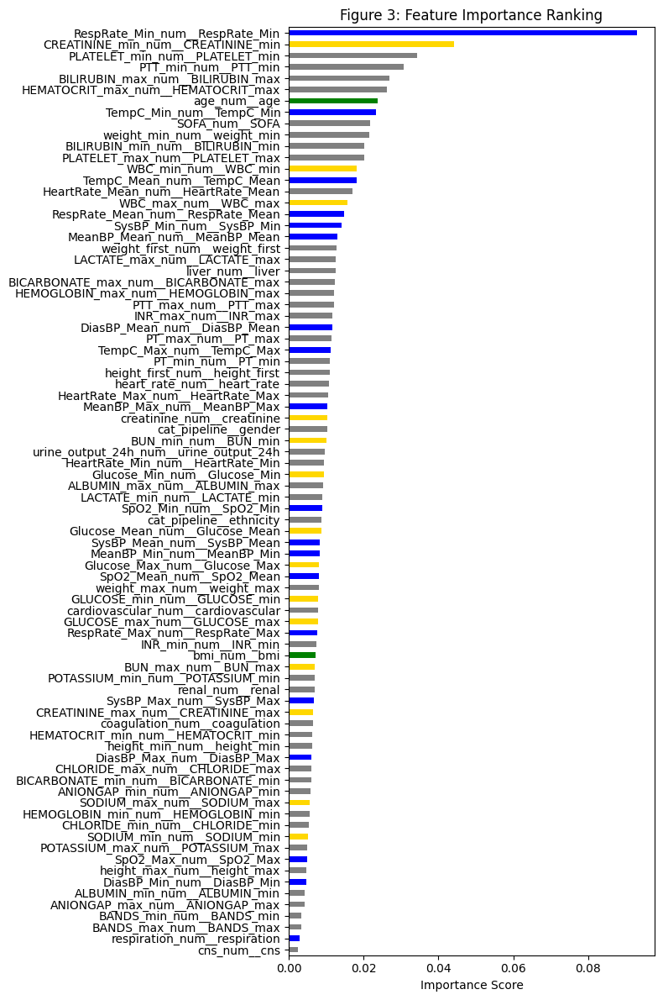

In [ ]:
plt.figure(figsize=(8, 12))
importances_series.plot(kind='barh', color=colors)
plt.title("Figure 3: Feature Importance Ranking")
plt.xlabel("Importance Score")
plt.tight_layout()
plt.show()

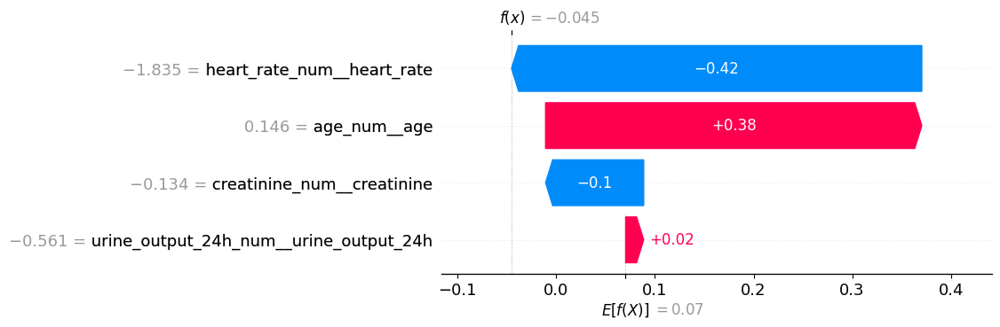

In [ ]:
# Recalculate SHAP values for a single sample
sample_idx = y[y == 0].sample(1, random_state=42).index[0]
X_sample = X_transformed[[sample_idx]]  # 2D

# Get list of SHAP value arrays: one per class
shap_values = explainer.shap_values(X_sample)

# We'll use class 0 (first output)
class_index = 0
shap_val_class_0 = shap_values[class_index][0]  # 1D explanation for sample

# Plot waterfall for class 0
shap.plots.waterfall(shap.Explanation(
    values=shap_val_class_0,
    base_values=explainer.expected_value[class_index],
    data=X_sample[0],
    feature_names=feature_names
))


In [ ]:
# Table 3: 10-fold CV
skf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)
xgb = XGBClassifier(use_label_encoder=False, eval_metric='mlogloss')
acc_scores = cross_val_score(xgb, X_transformed, y, cv=skf, scoring='accuracy')
mcc_scores = cross_val_score(xgb, X_transformed, y, cv=skf, scoring=lambda m, p: matthews_corrcoef(m, p))

table_3 = pd.DataFrame({
    "Fold": list(range(1, 11)),
    "Accuracy": acc_scores,
    "MCC": mcc_scores
})
table_3.loc["Mean"] = table_3.mean()
table_3.loc["Std"] = table_3.std()

c:\Users\home\anaconda3\envs\project1\Lib\site-packages\xgboost\training.py:183: UserWarning: [12:19:43] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
c:\Users\home\anaconda3\envs\project1\Lib\site-packages\xgboost\training.py:183: UserWarning: [12:19:56] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
c:\Users\home\anaconda3\envs\project1\Lib\site-packages\xgboost\training.py:183: UserWarning: [12:20:09] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
c:\Users\home\anaconda3\envs\project1\Lib\site-packages\xgboost\training.py:183: UserWarning: [12:20:23] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "

📊 Table 3 - 10-Fold Cross-Validation Results


,Fold,Accuracy,MCC
0,1.0000,0.9448,NaN
1,2.0000,0.9443,NaN
2,3.0000,0.9457,NaN
3,4.0000,0.9439,NaN
4,5.0000,0.9447,NaN
5,6.0000,0.9445,NaN
6,7.0000,0.9453,NaN
7,8.0000,0.9453,NaN
8,9.0000,0.9442,NaN
9,10.0000,0.9448,NaN


c:\Users\home\anaconda3\envs\project1\Lib\site-packages\xgboost\training.py:183: UserWarning: [12:31:53] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
c:\Users\home\anaconda3\envs\project1\Lib\site-packages\xgboost\training.py:183: UserWarning: [12:32:01] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
c:\Users\home\anaconda3\envs\project1\Lib\site-packages\xgboost\training.py:183: UserWarning: [12:32:10] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
c:\Users\home\anaconda3\envs\project1\Lib\site-packages\xgboost\training.py:183: UserWarning: [12:32:19] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "

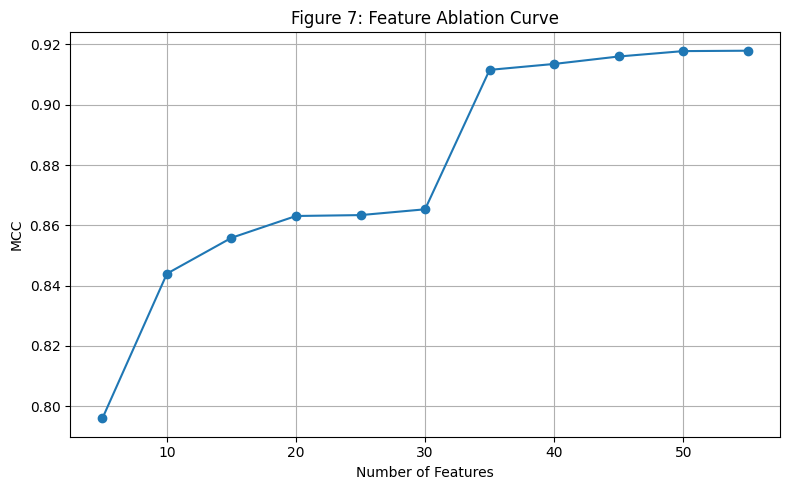

In [ ]:
print("📊 Table 3 - 10-Fold Cross-Validation Results")
display(table_3.round(4))

# Figure 7: Feature Ablation Curve
ablation_results = []
sorted_features = importances_series.sort_values(ascending=False)

for k in range(5, min(60, len(sorted_features) + 1), 5):
    top_k_features = sorted_features.head(k).index.tolist()
    indices = [i for i, f in enumerate(feature_names) if f in top_k_features]
    X_k = X_transformed[:, indices]
    xgb_model = XGBClassifier(use_label_encoder=False, eval_metric='mlogloss')
    xgb_model.fit(X_k, y)
    preds = xgb_model.predict(X_k)
    mcc = matthews_corrcoef(y, preds)
    ablation_results.append((k, mcc))

x_vals, y_vals = zip(*ablation_results)
plt.figure(figsize=(8, 5))
plt.plot(x_vals, y_vals, marker='o')
plt.xlabel("Number of Features")
plt.ylabel("MCC")
plt.title("Figure 7: Feature Ablation Curve")
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
model_names = ["XGBoost", "NaiveBayes", "LogisticRegression", "SVM","RandomForest"]

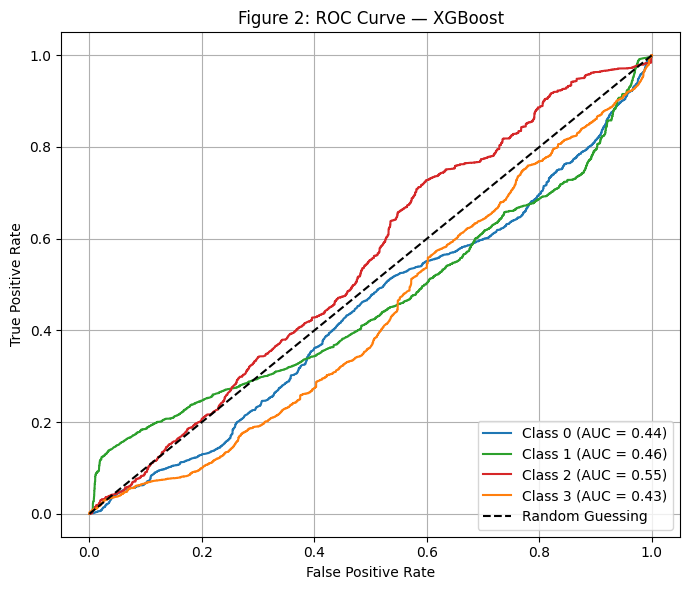

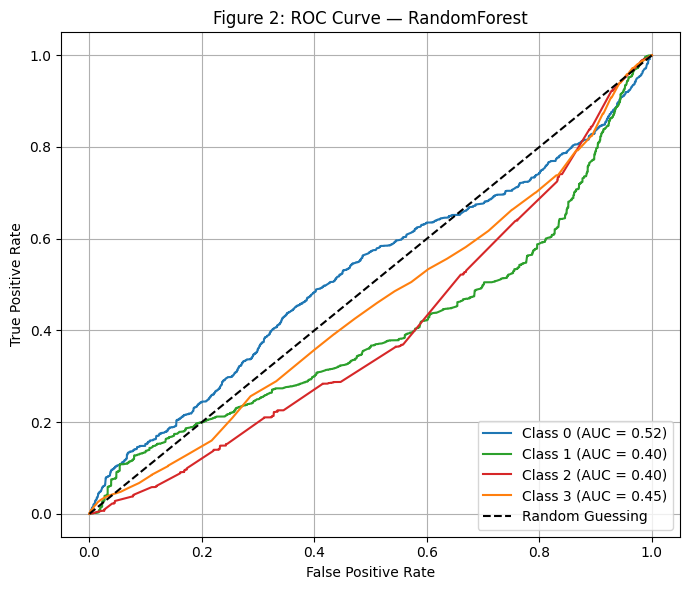

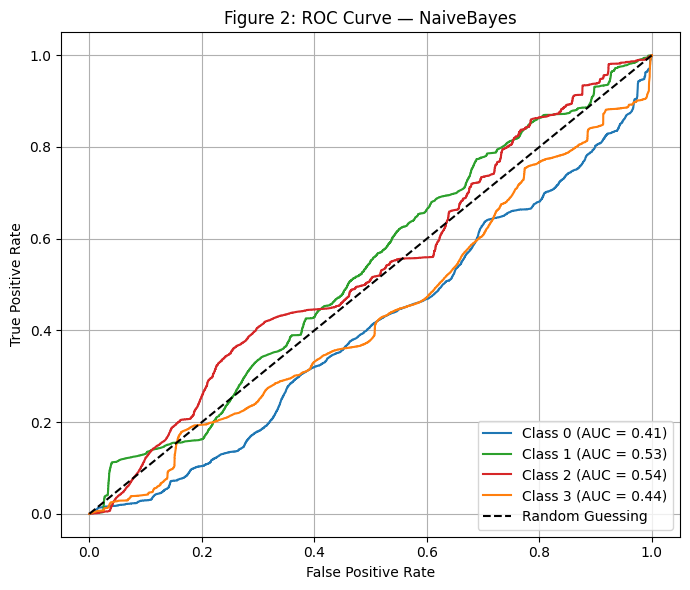

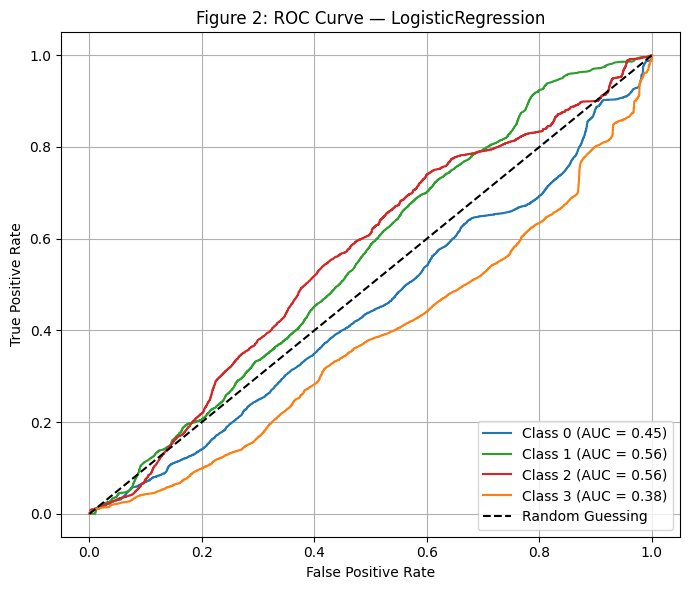

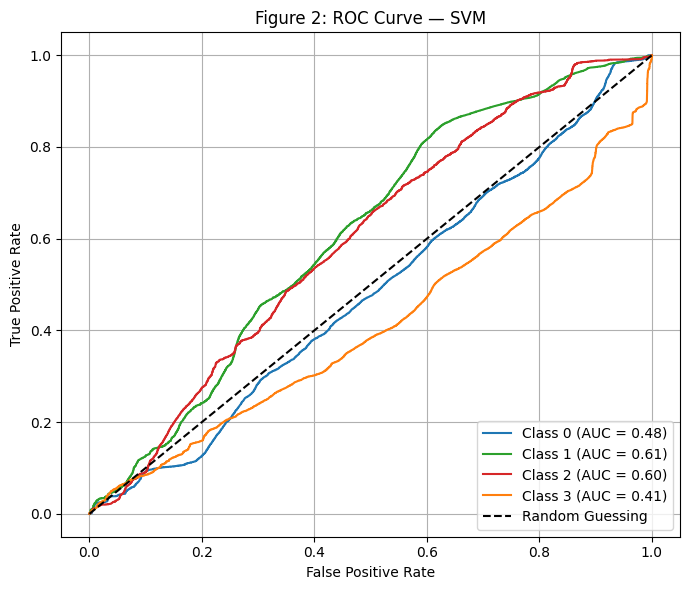

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
import joblib
import os

# Make sure you have X_test and y_test available
y_test_bin = label_binarize(y_test, classes=[0, 1, 2, 3])

model_cache = "model_cache"
feature_hash = "6ecc0db9ef10cd94429e965e4d514ad4"
model_names = ["XGBoost", "RandomForest", "NaiveBayes", "LogisticRegression", "SVM"]
colors = ['tab:blue', 'tab:green', 'tab:red', 'tab:orange']  # for class 0-3

for model_name in model_names:
    model_path = os.path.join(model_cache, f"{model_name}_{feature_hash}.joblib")

    if not os.path.exists(model_path):
        print(f"⚠️ Skipping {model_name} — model file not found.")
        continue

    model = joblib.load(model_path)

    try:
        y_score = model.predict_proba(X_test)
    except AttributeError:
        print(f"⚠️ Skipping {model_name} — model doesn't support predict_proba.")
        continue

    plt.figure(figsize=(7, 6))
    for i in range(4):
        fpr, tpr, _ = roc_curve(y_test_bin[:, i], y_score[:, i])
        roc_auc = auc(fpr, tpr)
        plt.plot(fpr, tpr, color=colors[i], label=f"Class {i} (AUC = {roc_auc:.2f})")

    plt.plot([0, 1], [0, 1], 'k--', label="Random Guessing")
    plt.title(f"Figure 2: ROC Curve — {model_name}")
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.tight_layout()
    plt.show()


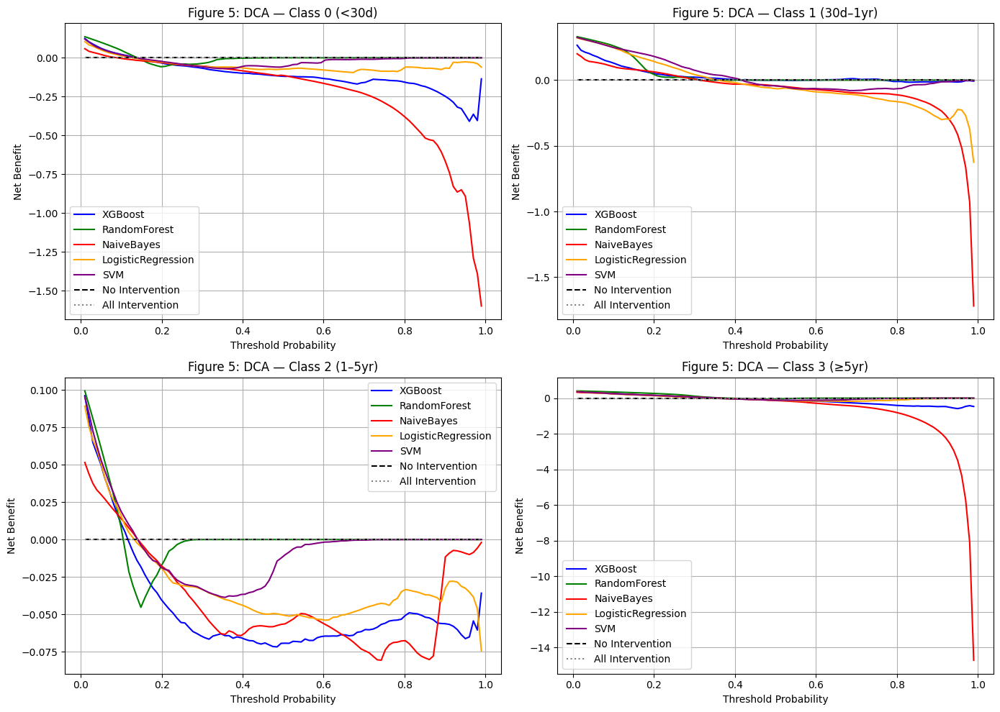

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import label_binarize
import joblib
import os

# Function to compute decision curve net benefit
def decision_curve_analysis(y_true, y_prob, thresholds=np.linspace(0.01, 0.99, 100)):
    net_benefits = []
    for threshold in thresholds:
        tp = ((y_prob >= threshold) & (y_true == 1)).sum()
        fp = ((y_prob >= threshold) & (y_true == 0)).sum()
        nb = (tp / len(y_true)) - (fp / len(y_true)) * (threshold / (1 - threshold))
        net_benefits.append(nb)
    return thresholds, np.array(net_benefits)

# Setup
model_names = ["XGBoost", "RandomForest", "NaiveBayes", "LogisticRegression", "SVM"]
colors = ['blue', 'green', 'red', 'orange', 'purple']
feature_hash = "6ecc0db9ef10cd94429e965e4d514ad4"
model_cache = "model_cache"

# Binarize target labels
y_test_bin = label_binarize(y_test, classes=[0, 1, 2, 3])
thresholds = np.linspace(0.01, 0.99, 100)
class_labels = ['Class 0 (<30d)', 'Class 1 (30d–1yr)', 'Class 2 (1–5yr)', 'Class 3 (≥5yr)']

# Plot 4 subplots, one per class
fig, axes = plt.subplots(2, 2, figsize=(14, 10))
axes = axes.ravel()

for class_idx in range(4):
    ax = axes[class_idx]
    y_true_class = y_test_bin[:, class_idx]

    for model_name, color in zip(model_names, colors):
        model_path = os.path.join(model_cache, f"{model_name}_{feature_hash}.joblib")
        if not os.path.exists(model_path):
            print(f"⚠️ {model_name} not found, skipping.")
            continue
        model = joblib.load(model_path)

        if not hasattr(model, "predict_proba"):
            print(f"⚠️ {model_name} has no predict_proba, skipping.")
            continue

        try:
            y_probs = model.predict_proba(X_test)
            y_prob_class = y_probs[:, class_idx]
        except:
            continue

        t, net_benefit = decision_curve_analysis(y_true_class, y_prob_class, thresholds)
        ax.plot(t, net_benefit, label=model_name, color=color)

    ax.plot(thresholds, np.zeros_like(thresholds), 'k--', label="No Intervention")
    ax.plot(thresholds, thresholds - thresholds, 'gray', linestyle=':', label="All Intervention")
    ax.set_title(f"Figure 5: DCA — {class_labels[class_idx]}")
    ax.set_xlabel("Threshold Probability")
    ax.set_ylabel("Net Benefit")
    ax.legend()
    ax.grid(True)

plt.tight_layout()
plt.show()
